# Experimentos con Tetrad 7.1.2-2

* Nueva versión 7.1.2-2 de Tetrad
* Grandes mejoras de rendimiento, tanto en tiempo como en puntuación
* Comparación frente a fGES

In [1]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

pd.options.display.max_info_rows = 30000000

sns.set_theme(style='darkgrid')

# Tamaño figuras
plt.rcParams["figure.figsize"] = (20,8)
plt.rcParams["figure.dpi"] = 600

pd.options.mode.chained_assignment = None

# Paleta de colores tiempo
color = ['#264653', '#2a9d8f', '#e9c46a', '#f4a261', '#e76f51', '#b13c47']

# Paleta de colores BDeu
color2 = ['#264653', '#2a9d8f', '#e9c46a', '#f4a261', '#e76f51', '#b13c47']

# Paleta de colores BDeu sin Fges
color3 = ['#2a9d8f', '#e9c46a', '#f4a261', '#e76f51', '#b13c47']

In [2]:
df = pd.read_csv('results-new-BDeu.csv')
#df['threads'] = pd.Categorical(df.threads)
#df['threadsPGES'] = pd.Categorical(df.threadsPGES)
df['interleaving'] = pd.Categorical(df.interleaving)

df['algorithm'] = df['algorithm'].replace('ges', 'GES')
df['algorithm'] = df['algorithm'].replace('pges', 'pGES')
df['algorithm'] = df['algorithm'].replace('fges', 'Fges')
df['algorithm'] = df['algorithm'].replace('fges-faithfulness', 'Fges-faithfulness')

# only df that ends in xbif50003_
#df = df[df['bbdd'].str.endswith('xbif50003_')]
df

,algorithm,network,bbdd,threads,threadsPGES,interleaving,seed,SHD,LL Score,BDeu Score,dfMM,dfMM plus,dfMM minus,Total iterations,Total time(s)
0,Fges,alarm,alarm.xbif50001246_,16,0,0,-1,7,-0.281438,-54069.673911,14.0,0.0,14.0,1,0.995
1,Fges,alarm,alarm.xbif50001246_,1,0,0,-1,7,0.000000,-54069.673911,14.0,0.0,14.0,1,1.901
2,Fges,alarm,alarm.xbif50001246_,2,0,0,-1,7,0.000000,-54069.673911,14.0,0.0,14.0,1,1.221
3,Fges,alarm,alarm.xbif50001246_,4,0,0,-1,7,0.000000,-54069.673911,14.0,0.0,14.0,1,1.089
4,Fges,alarm,alarm.xbif50001246_,8,0,0,-1,7,0.000000,-54069.673911,14.0,0.0,14.0,1,1.019
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18735,pGES,win95pts,win95pts.xbif_,8,8,15,2,55,-0.222579,-47058.872400,148.0,76.0,72.0,5,2.811
18736,pGES,win95pts,win95pts.xbif_,8,8,20,2,63,-0.217616,-47086.678393,154.0,74.0,80.0,100,20.854
18737,pGES,win95pts,win95pts.xbif_,8,8,30,2,65,-0.216946,-47080.297522,162.0,82.0,80.0,4,3.320
18738,pGES,win95pts,win95pts.xbif_,8,8,50,2,67,-0.222706,-47088.716464,152.0,64.0,88.0,3,2.671


## Resumen del tiempo de ejecución, BDeu y el número de experimentos ejecutados

In [3]:
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 100)
df_unstack = df.drop(["bbdd", "interleaving", "seed", "SHD", "LL Score", "BDeu Score", "dfMM", "dfMM plus", "dfMM minus", "Total iterations"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "threadsPGES"], observed=True).mean().unstack(0)

Total time(s)                         \
network                                       alarm       andes     barley   
algorithm         threads threadsPGES                                        
Fges              1       0                2.448182    4.433273   6.699364   
                  2       0                1.518909    3.752273   5.929727   
                  4       0                1.381545    3.559727   5.612727   
                  8       0                1.207818    3.506818   5.217909   
                  16      0                1.275000    3.332545   5.176000   
Fges-faithfulness 1       0                2.737364   12.469091  14.406273   
                  2       0                1.747909   11.799818  14.170182   
                  4       0                1.581727   11.304273  13.671182   
                  8       0                1.362000   10.846636  12.759727   
                  16      0                1.370727   10.793273  12.641273   
GES               1       0                2.326818   50.870000   5.593273   
                  2       0                1.044273   34.227818   3.256909   
                  4       0                1.038091   30.597636   3.337364   
                  8       0                0.968636   23.599727   2.427545   
                  16      0                1.057909   19.372273   2.031545   
pGES              2       2                2.102558   50.076545   7.730312   
                          4                2.456364   55.859312   5.668792   
                          8                2.945338   91.327390   8.398234   
                          16               4.013883  153.396506   9.086610   
                  4       2                1.593727   43.124481   5.919104   
                          4                2.214013   49.535961   4.929883   
                          8                2.449558   84.456494   6.767870   
                          16               3.015325  147.251987   8.511649   
                  8       2                1.408948   40.574026   5.082416   
                          4                1.771961   47.389351   4.254000   
                          8                2.093636   82.002610   5.340091   
                          16               2.447299  140.215182   6.662662   
                  16      2                1.439299   35.714065   4.590104   
                          4                1.728182   43.302104   3.903740   
                          8                1.975844   74.145623   5.027481   
                          16               2.268442  127.859026   5.583844   

                                                                           \
network                                   child earthquake     hailfinder   
algorithm         threads threadsPGES                                       
Fges              1       0            7.728273   3.100818    1715.670455   
                  2       0            6.005364   0.271636    1779.249000   
                  4       0            5.914182   0.276091    1721.524182   
                  8       0            5.950091   0.266727    1679.611727   
                  16      0            5.463000   0.265091   97653.034273   
Fges-faithfulness 1       0            8.368273   3.145091    1732.123182   
                  2       0            6.662545   0.277182    1779.615636   
                  4       0            6.832364   0.273727    1741.076091   
                  8       0            6.113545   0.264455    1684.027909   
                  16      0            6.086091   0.293000  291333.222909   
GES               1       0            0.821545   0.397545       2.786636   
                  2       0            0.610000   0.267727       1.675636   
                  4       0            0.584273   0.286273       1.870545   
                  8       0            0.565727   0.291091       1.961091   
                  16      0            0.591273   0.290091       1.795636   

In [4]:
df_unstack = df.drop(["bbdd", "interleaving", "seed", "SHD", "LL Score", "Total time(s)", "dfMM", "dfMM plus", "dfMM minus", "Total iterations"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "threadsPGES"], observed=True).mean().unstack(0)

BDeu Score                 \
network                                       alarm          andes   
algorithm         threads threadsPGES                                
Fges              1       0           -53941.914187 -473700.571827   
                  2       0           -53941.914187 -473700.571827   
                  4       0           -53941.914187 -473700.571827   
                  8       0           -53941.914187 -473700.571827   
                  16      0           -53941.914187 -473700.571827   
Fges-faithfulness 1       0           -53941.914187 -472615.160489   
                  2       0           -53941.914187 -472615.160489   
                  4       0           -53941.914187 -472615.160489   
                  8       0           -53941.914187 -472615.160489   
                  16      0           -53941.914187 -472615.160489   
GES               1       0           -54295.549824 -471573.248826   
                  2       0           -54295.549824 -471573.248826   
                  4       0           -54295.549824 -471573.248826   
                  8       0           -54295.549824 -471573.248826   
                  16      0           -54295.549824 -471573.248826   
pGES              2       2           -53958.965863 -471605.814190   
                          4           -53949.946422 -471643.902970   
                          8           -53984.119284 -471595.165000   
                          16          -53974.812654 -471603.669594   
                  4       2           -53958.965863 -471604.891010   
                          4           -53949.946422 -471646.238554   
                          8           -53986.891682 -471595.165000   
                          16          -53970.800174 -471602.694203   
                  8       2           -53958.965863 -471605.814190   
                          4           -53949.946422 -471645.678227   
                          8           -53989.377409 -471595.165000   
                          16          -53970.946859 -471602.103049   
                  16      2           -53958.965863 -471605.860538   
                          4           -53949.946422 -471643.902970   
                          8           -53981.756997 -471595.165000   
                          16          -53974.812654 -471603.669594   

                                                                    \
network                                       barley         child   
algorithm         threads threadsPGES                                
Fges              1       0           -266787.732646 -62293.624169   
                  2       0           -266787.732646 -62293.624169   
                  4       0           -266787.732646 -62293.624169   
                  8       0           -266787.732646 -62293.624169   
                  16      0           -266787.732646 -62293.624169   
Fges-faithfulness 1       0           -264192.664168 -62274.809319   
                  2       0           -264192.664168 -62274.809319   
                  4       0           -264192.664168 -62274.809319   
                  8       0           -264192.664168 -62274.809319   
                  16      0           -264192.664168 -62274.809319   
GES               1       0           -265981.525242 -62345.980012   
                  2       0           -265981.525242 -62345.980012   
                  4       0           -265981.525242 -62345.980012   
                  8       0           -265981.525242 -62345.980012   
                  16      0           -265981.525242 -62345.980012   
pGES              2       2           -264571.996389 -62135.984173   
                          4           -264877.872496 -62135.762738   
                          8           -265141.798028 -62141.002997   
                          16          -267193.059047 -62118.326928   
                  4       2           -264540.188123 -62135.984173   
                          4           -264877.8724

In [5]:
df_unstack.groupby(["network", "algorithm", "threads", "threadsPGES"], observed=True).count().unstack(0)

BDeu Score                     \
network                                    alarm andes barley child   
algorithm         threads threadsPGES                                 
Fges              1       0                 11.0  11.0   11.0  11.0   
                  2       0                 11.0  11.0   11.0  11.0   
                  4       0                 11.0  11.0   11.0  11.0   
                  8       0                 11.0  11.0   11.0  11.0   
                  16      0                 11.0  11.0   11.0  11.0   
Fges-faithfulness 1       0                 11.0  11.0   11.0  11.0   
                  2       0                 11.0  11.0   11.0  11.0   
                  4       0                 11.0  11.0   11.0  11.0   
                  8       0                 11.0  11.0   11.0  11.0   
                  16      0                 11.0  11.0   11.0  11.0   
GES               1       0                 11.0  11.0   11.0  11.0   
                  2       0                 11.0  11.0   11.0  11.0   
                  4       0                 11.0  11.0   11.0  11.0   
                  8       0                 11.0  11.0   11.0  11.0   
                  16      0                 11.0  11.0   11.0  11.0   
pGES              2       2                 77.0  77.0   77.0  77.0   
                          4                 77.0  77.0   77.0  77.0   
                          8                 77.0  77.0   77.0  77.0   
                          16                77.0  77.0   77.0  77.0   
                  4       2                 77.0  77.0   77.0  77.0   
                          4                 77.0  77.0   77.0  77.0   
                          8                 77.0  77.0   77.0  77.0   
                          16                77.0  77.0   77.0  77.0   
                  8       2                 77.0  77.0   77.0  77.0   
                          4                 77.0  77.0   77.0  77.0   
                          8                 77.0  77.0   77.0  77.0   
                          16                77.0  77.0   77.0  77.0   
                  16      2                 77.0  77.0   77.0  77.0   
                          4                 77.0  77.0   77.0  77.0   
                          8                 77.0  77.0   77.0  77.0   
                          16                77.0  77.0   77.0  77.0   

                                                                              \
network                               earthquake hailfinder hepar2 insurance   
algorithm         threads threadsPGES                                          
Fges              1       0                 11.0       11.0   11.0      11.0   
                  2       0                 11.0       11.0   11.0      11.0   
                  4       0                 11.0       11.0   11.0      11.0   
                  8       0                 11.0       11.0   11.0      11.0   
                  16      0                 11.0       11.0   11.0      11.0   
Fges-faithfulness 1       0                 11.0       11.0   11.0      11.0   
                  2       0                 11.0       11.0   11.0      11.0   
                  4       0                 11.0       11.0   11.0      11.0   
                  8       0                 11.0       11.0   11.0      11.0   
                  16      0                 11.0       11.0   11.0      11.0   
GES               1       0                 11.0       11.0   11.0      11.0   
                  2       0                 11.0       11.0   11.0      11.0   
                  4       0                 11.0       11.0   11.0      11.0   
                  8       0                 11.0       11.0   11.0      11.0   
                  16      0                 11.0       11.0   11.0      11.0   
pGES              2       2                 77.0       77.0   77.0      77.0   
                          4                 77.0       77.0   77.0      77.0   
                       

In [6]:
df['alg'] = np.where(((df['algorithm']=='pGES')), 'pGES' + ' ' + df["threadsPGES"].astype(str), df["algorithm"])

df = df.sort_values(by=['threadsPGES'])

# Gráficas

In [7]:
def plot(network, variable, precision, size, interleaving=False, removeFges=False):    
    df_temp = df[df["network"] == network]
    
    paleta = color2
    if removeFges:
        df_temp = df_temp[df_temp["algorithm"] != "Fges"]
        df_temp = df_temp[df_temp["algorithm"] != "Fges-faithfulness"]
        if variable == "BDeu Score" or variable == "SHD":
            paleta = color3
    
    # Order of the bars: fges, ges, pges
    if removeFges:
        order = ["GES", "pGES 2", "pGES 4", "pGES 8", "pGES 16"]
    else:
        order = ["Fges", "Fges-faithfulness", "GES", "pGES 2", "pGES 4", "pGES 8", "pGES 16"]

    # Gráfico de barras, sin leyenda (se crea después)
    if variable == "BDeu Score":
        if interleaving:
            ax = sns.barplot(data=df_temp, x="alg", hue="interleaving", y=variable, ci=None, palette=paleta, order=order)
        else:
            ax = sns.barplot(data=df_temp, x="alg", y=variable, ci=None, palette=paleta, order=order)
        min = df_temp[variable].min()*1.01
        max = df_temp[variable].max()*0.93
        ax.set_ylim(min, max)
        texto = "BDeu:  " + network
    elif variable == "SHD":
        if interleaving:
            ax = sns.barplot(data=df_temp, x="alg", hue="interleaving", y=variable, ci=None, palette=paleta, order=order)
        else:
            ax = sns.barplot(data=df_temp, x="alg", y=variable, ci=None, palette=paleta, order=order)
        texto = "SHD:  " + network
    elif variable == "Total time(s)":
        if interleaving:
            # Create a new variable joining threads and interleaving
            ax = sns.barplot(data=df_temp, x="alg", y=variable, hue="interleaving", ci=None, palette=color, order=order)
        else:
            ax = sns.barplot(data=df_temp, x="alg", y=variable, hue='threads', ci=None, palette=color, order=order)
        texto = "tiempo:  " + network

    ax.set_title('Comparativa ' + texto, fontsize=16)
    ax.set_xlabel('Algoritmo', fontsize=14)
    ax.set_ylabel(variable, fontsize=14)

    # Imprimir valores de las barras en la parte superior
    for p in ax.patches:
        if not np.isnan(p.get_height()):
            altura = p.get_height()
            if variable == "BDeu Score":
                altura -= (max-min)*0.03

            
            # Imprimir valores de las barras en la parte inferior
            ax.text(p.get_x() + p.get_width()/2., altura, ('{0:.'+str(precision)+'f}').format(p.get_height()), ha='center', va='bottom', fontsize=size) 
    
    # Rotar labels inferiores
    plt.xticks(rotation=45)
        
    plt.plot

## Gráficas comparativas vs fGES

### Hailfinder

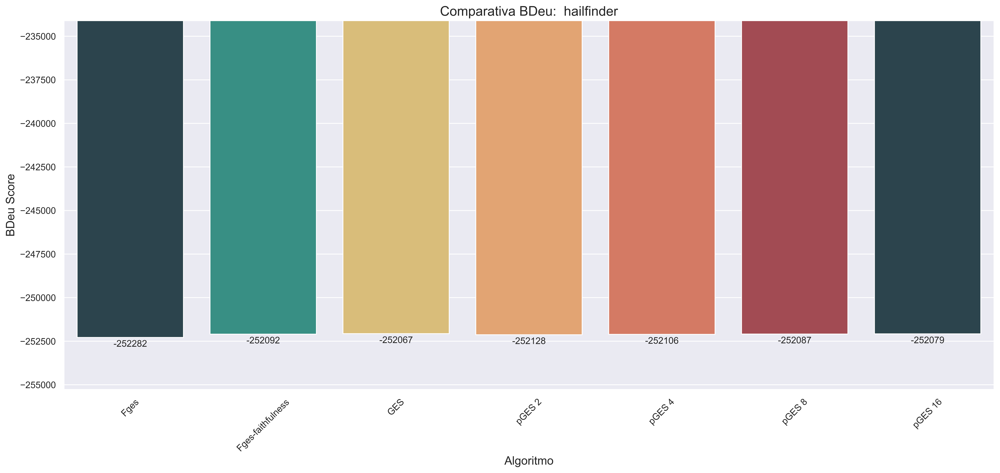

In [228]:
plot("hailfinder", "BDeu Score", 0, 11)

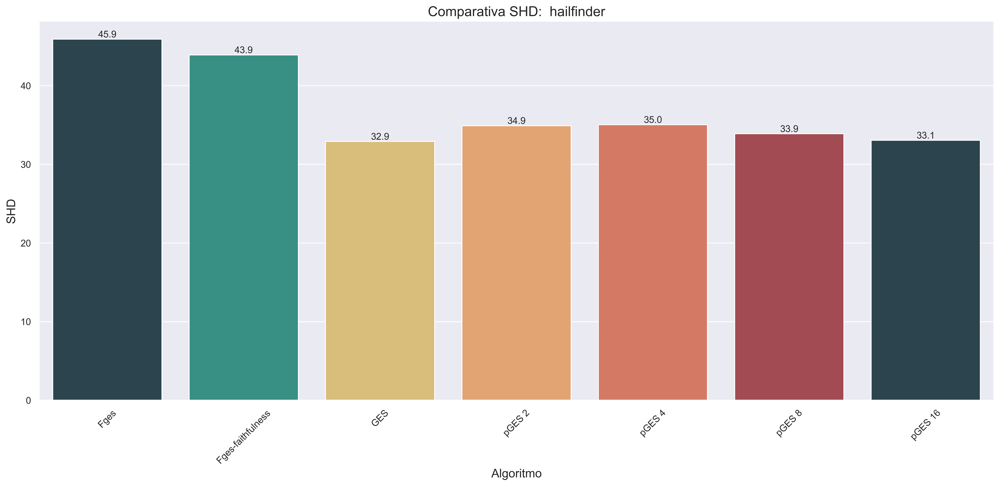

In [229]:
plot("hailfinder", "SHD", 1, 11)

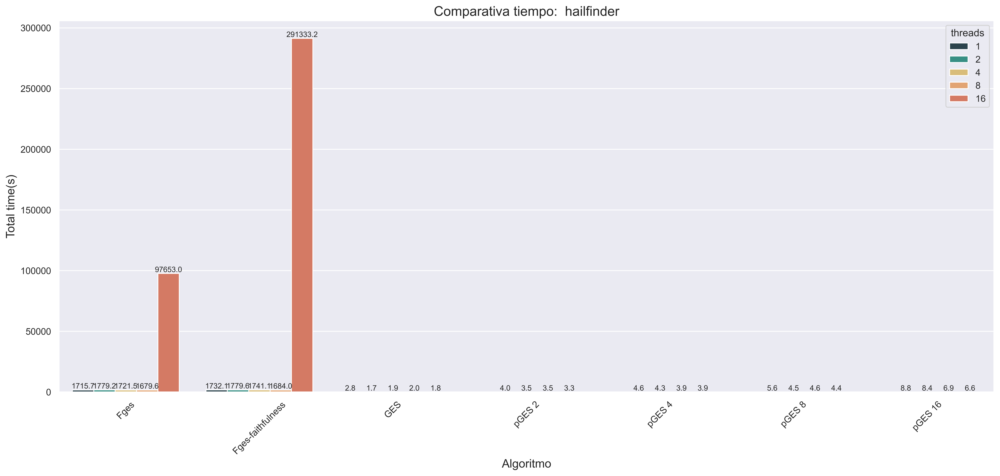

In [230]:
plot("hailfinder", "Total time(s)", 1, 9)

### Andes

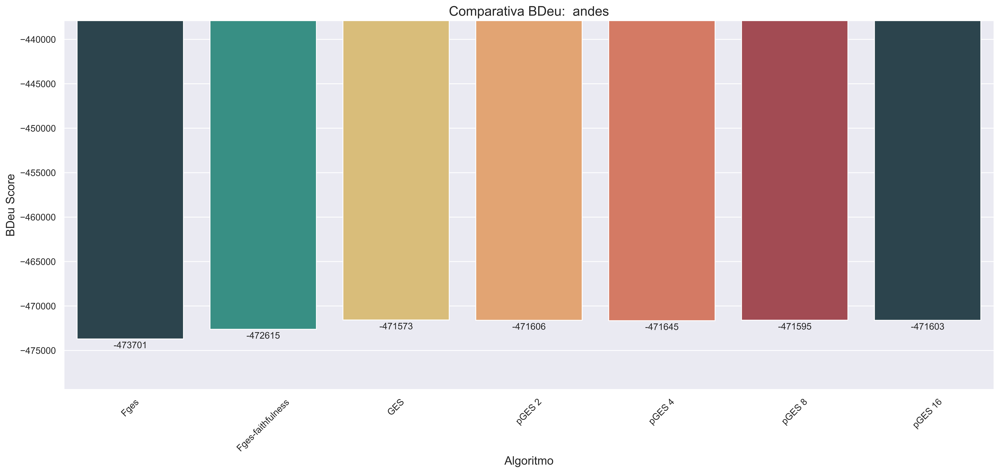

In [231]:
plot("andes", "BDeu Score", 0, 11)

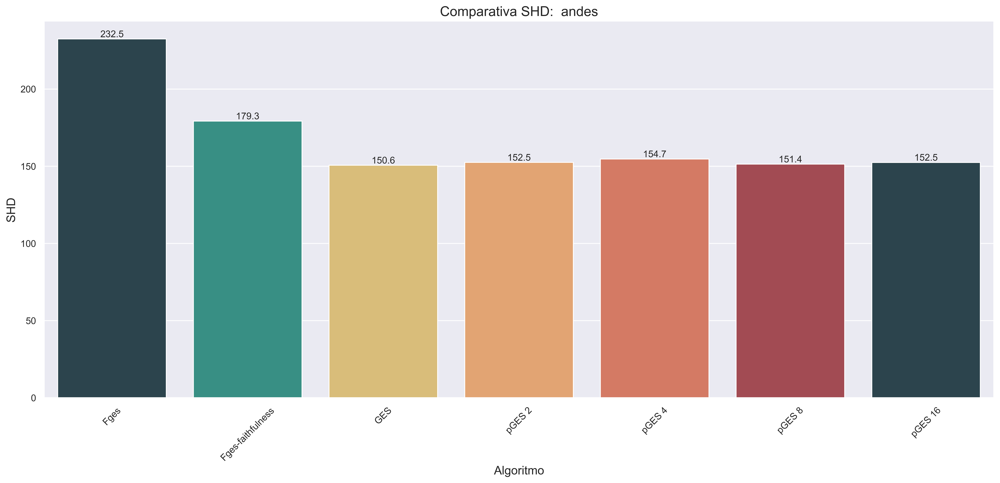

In [232]:
plot("andes", "SHD", 1, 11)

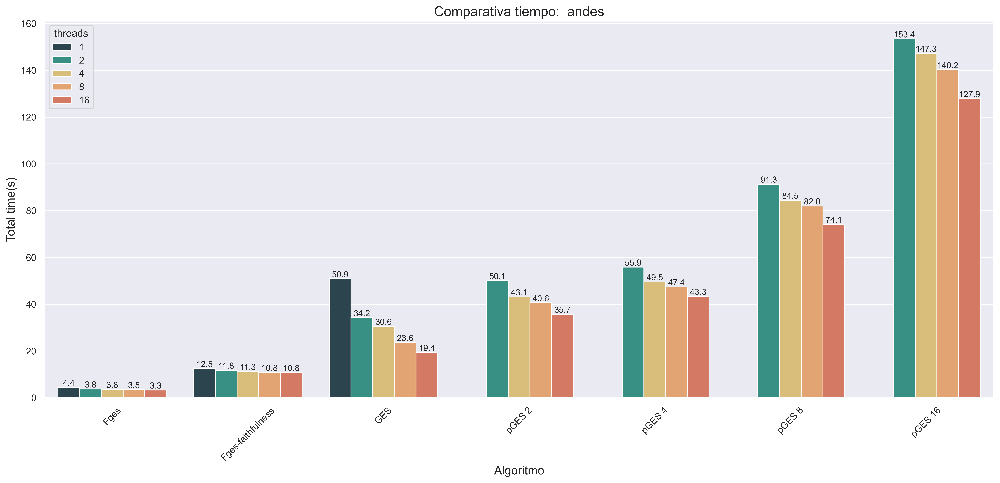

In [233]:
plot("andes",  "Total time(s)", 1, 10)

### Pigs

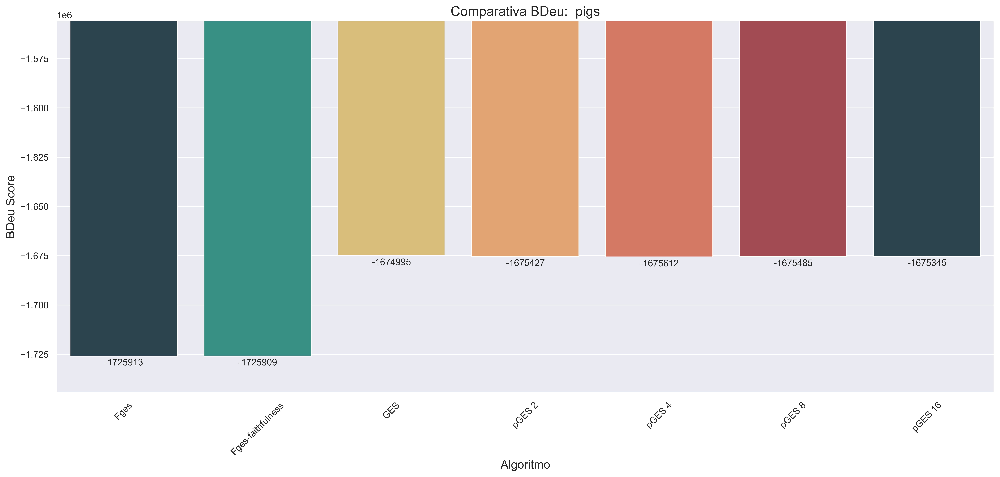

In [234]:
plot("pigs", "BDeu Score", 0, 11)

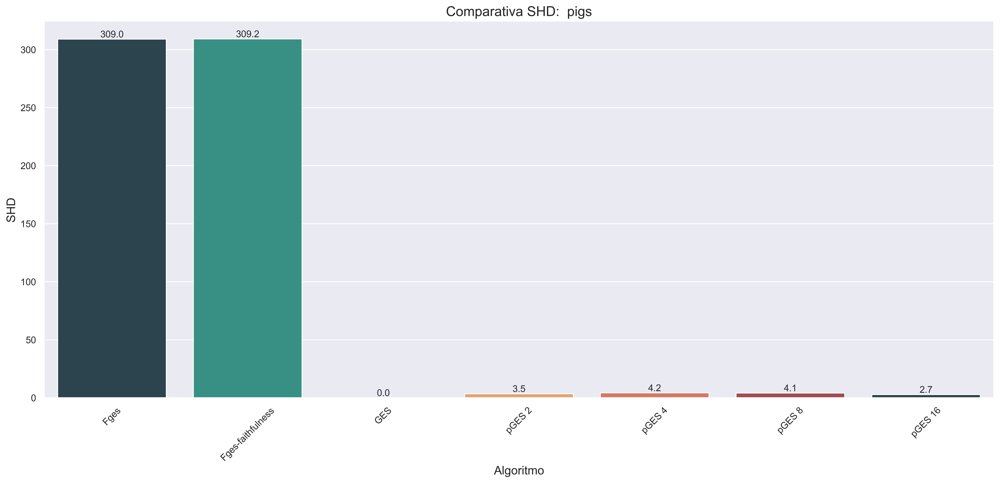

In [235]:
plot("pigs", "SHD", 1, 11)

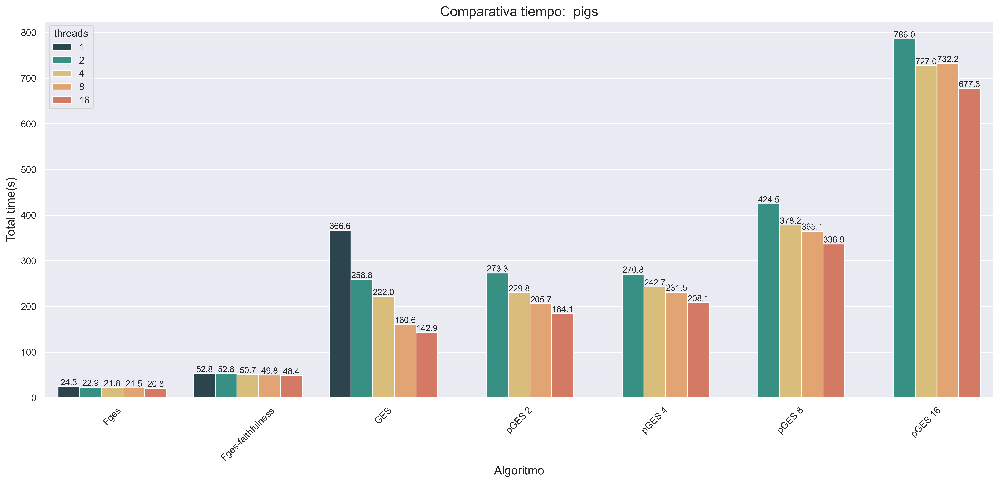

In [236]:
plot("pigs",  "Total time(s)", 1, 10)

### Link

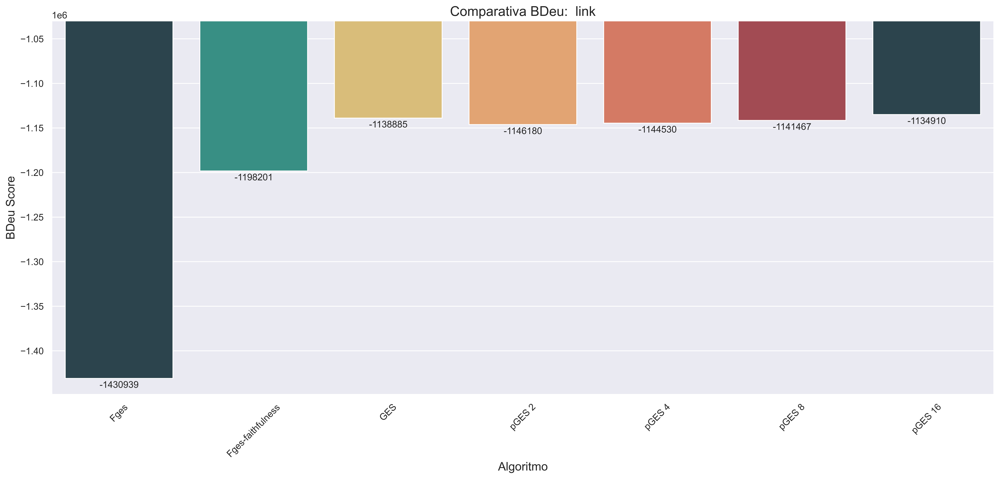

In [237]:
plot("link", "BDeu Score", 0, 11)

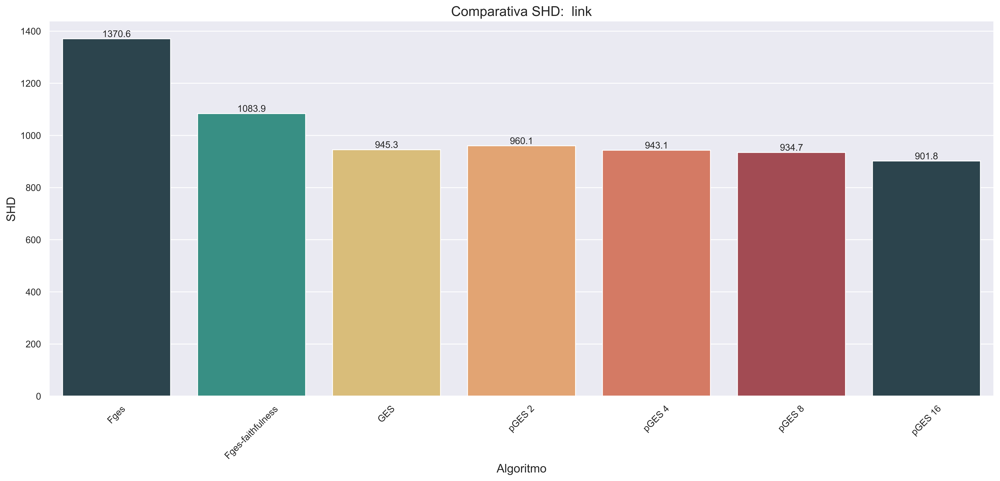

In [238]:
plot("link", "SHD", 1, 11)

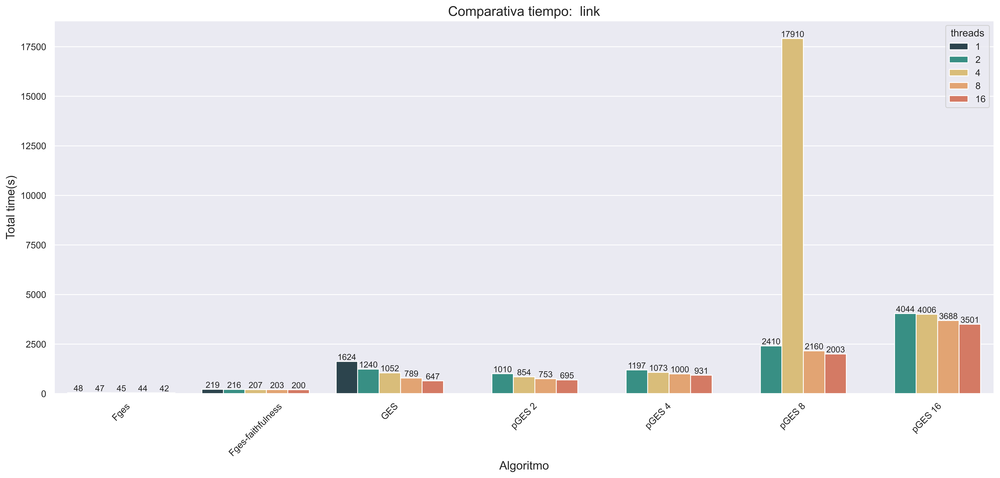

In [239]:
plot("link",  "Total time(s)", 0, 10)

### Munin

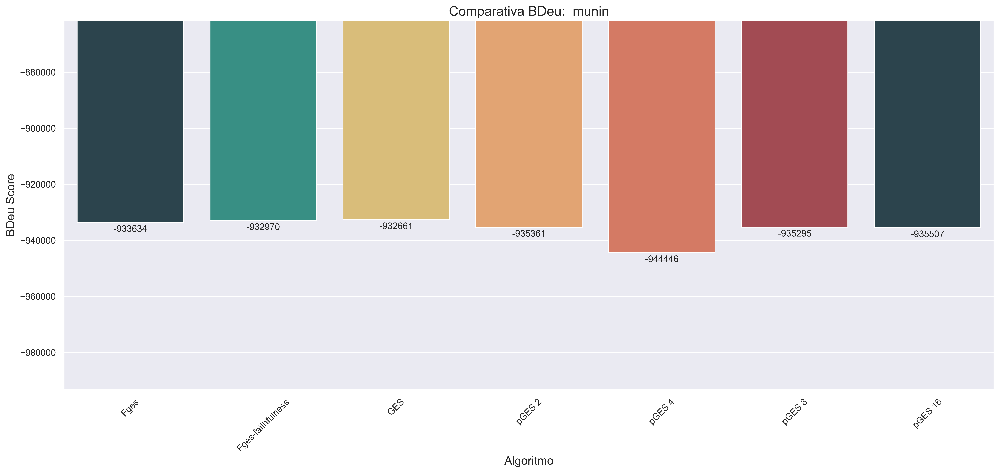

In [240]:
plot("munin", "BDeu Score", 0, 11)

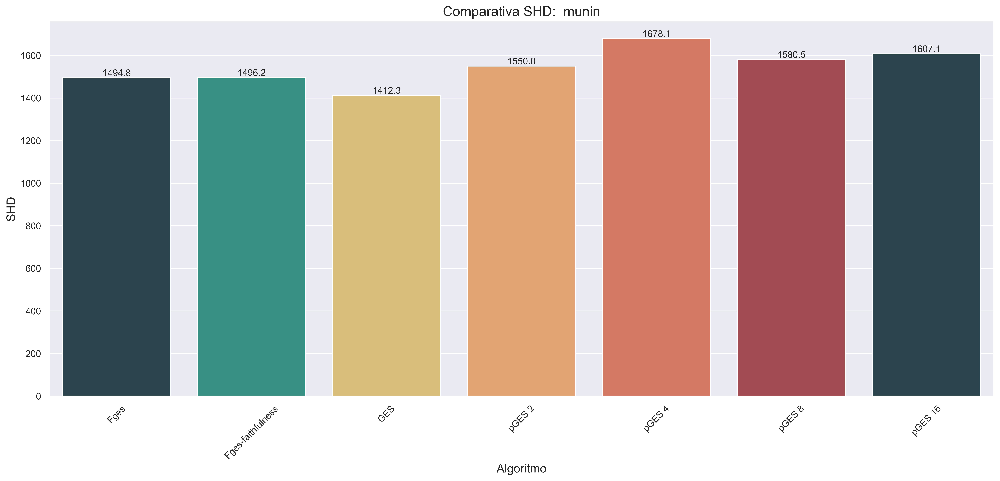

In [241]:
plot("munin", "SHD", 1, 11)

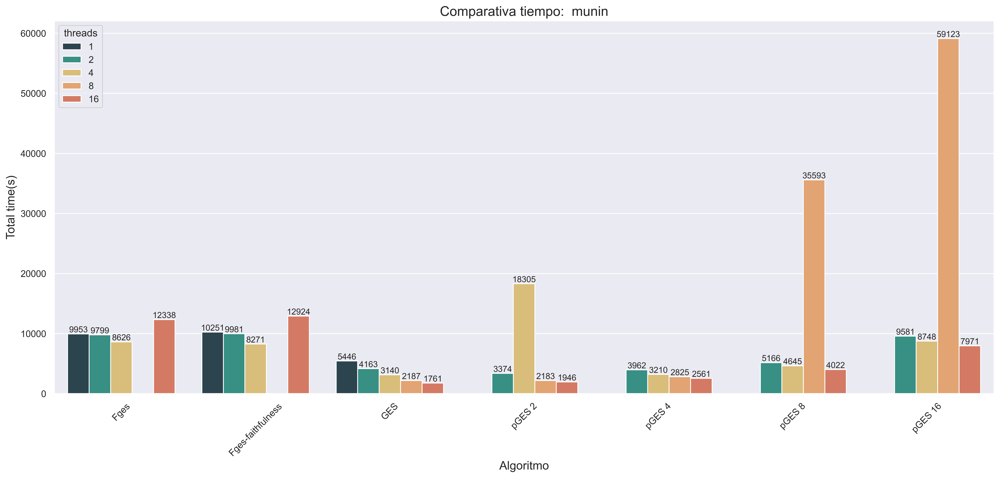

In [242]:
plot("munin", "Total time(s)", 0, 10)

## Gráficas comparativas interleaving

### Hailfinder

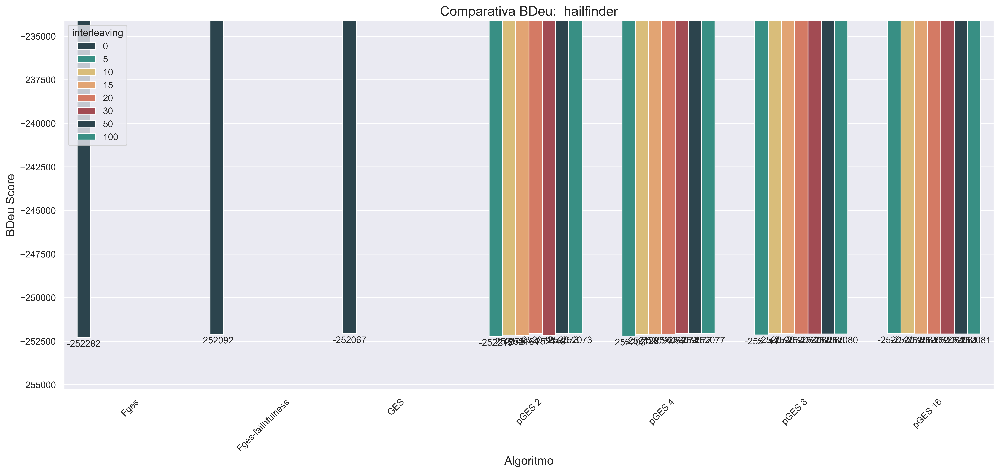

In [243]:
plot("hailfinder", "BDeu Score", 0, 11, interleaving=True)

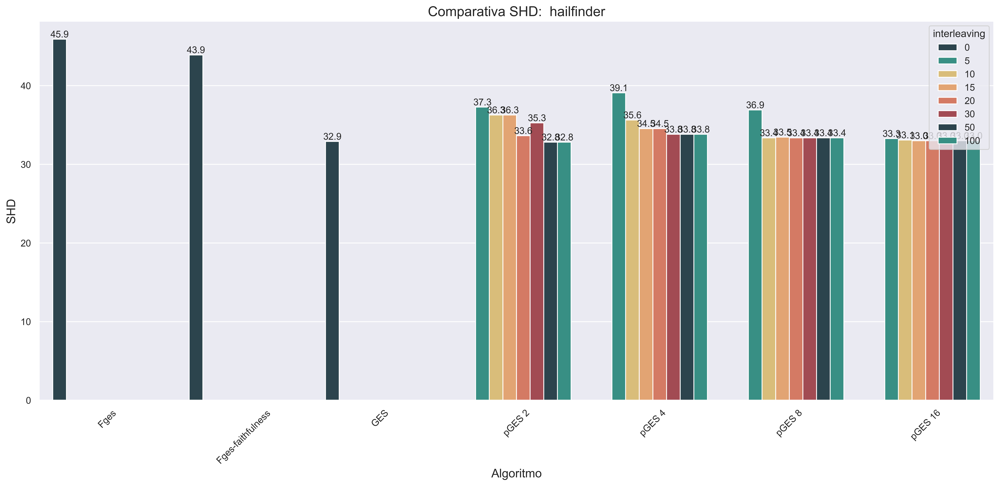

In [244]:
plot("hailfinder", "SHD", 1, 11, interleaving=True)

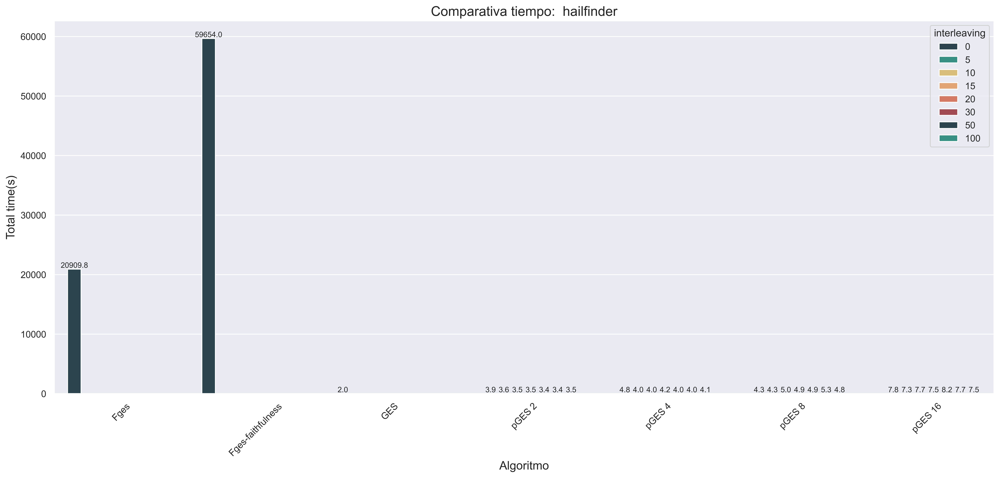

In [245]:
plot("hailfinder", "Total time(s)", 1, 9, interleaving=True)

### Andes

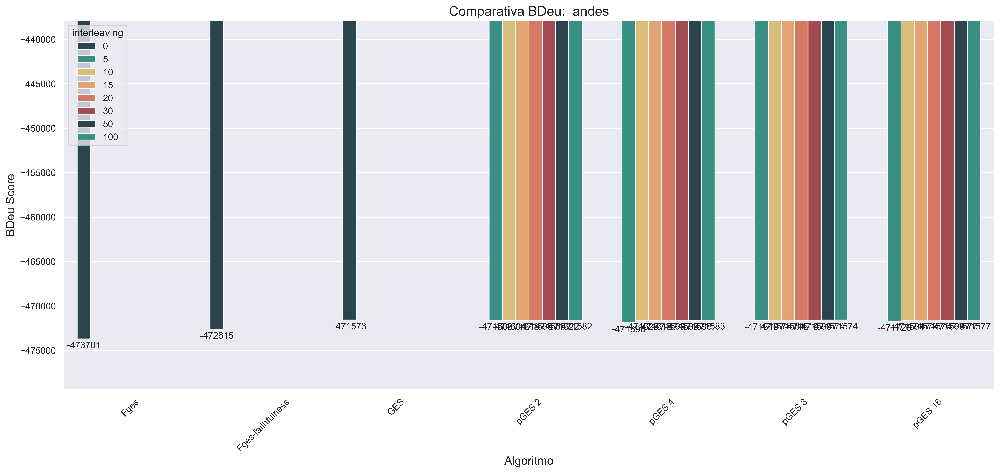

In [246]:
plot("andes", "BDeu Score", 0, 11, interleaving=True)

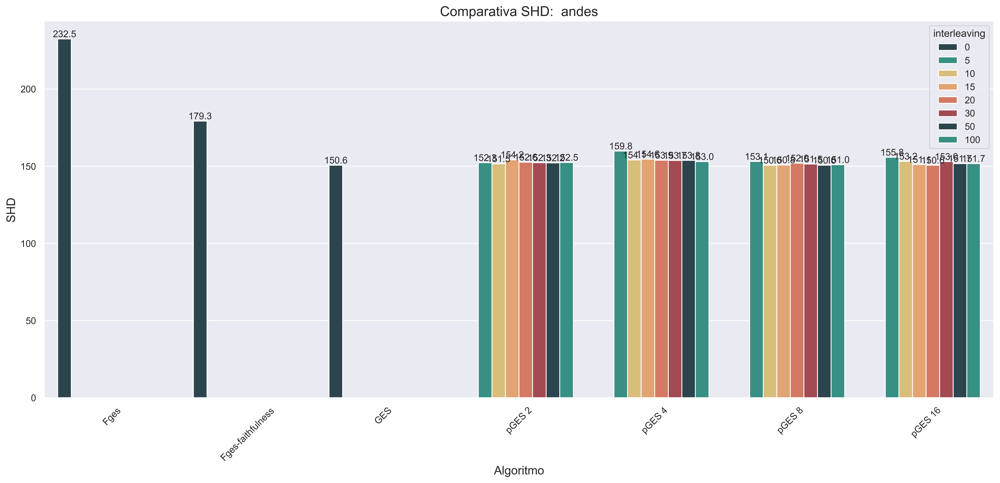

In [247]:
plot("andes", "SHD", 1, 11, interleaving=True)

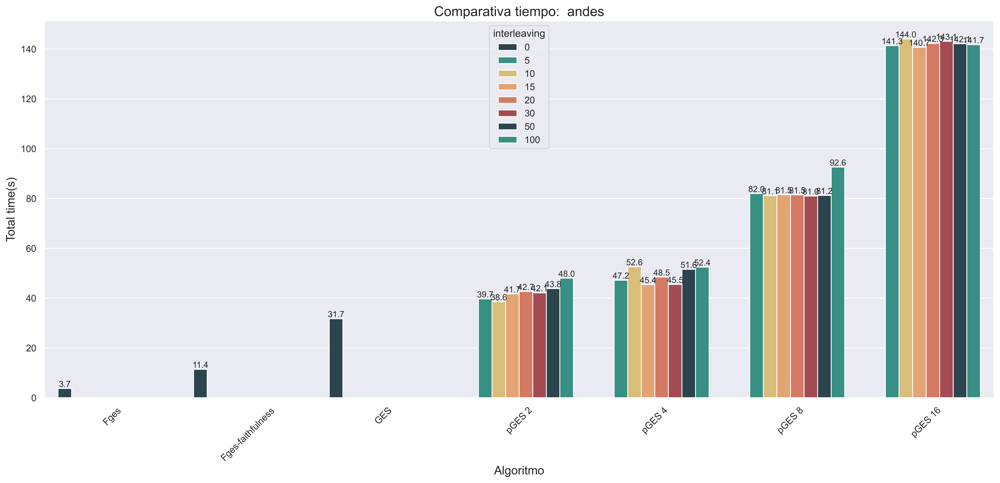

In [248]:
plot("andes",  "Total time(s)", 1, 10, interleaving=True)

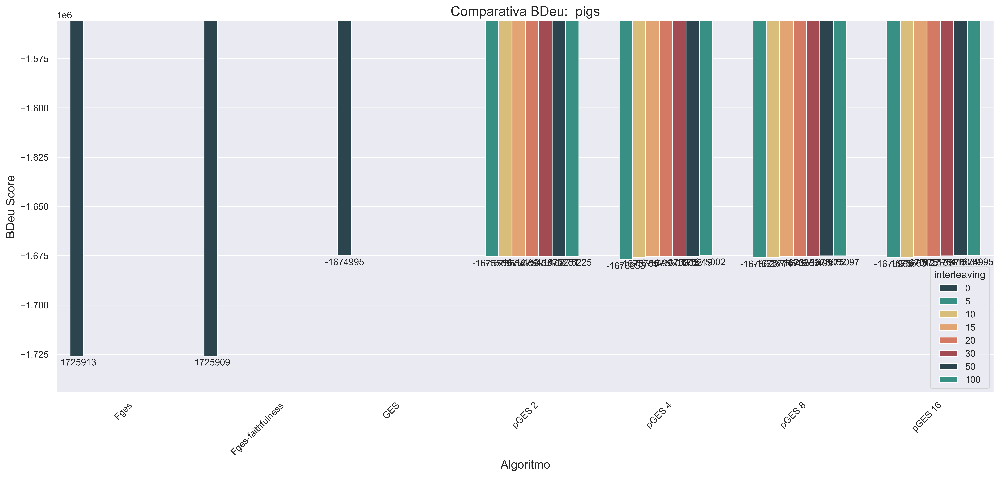

In [249]:
plot("pigs", "BDeu Score", 0, 11, interleaving=True)

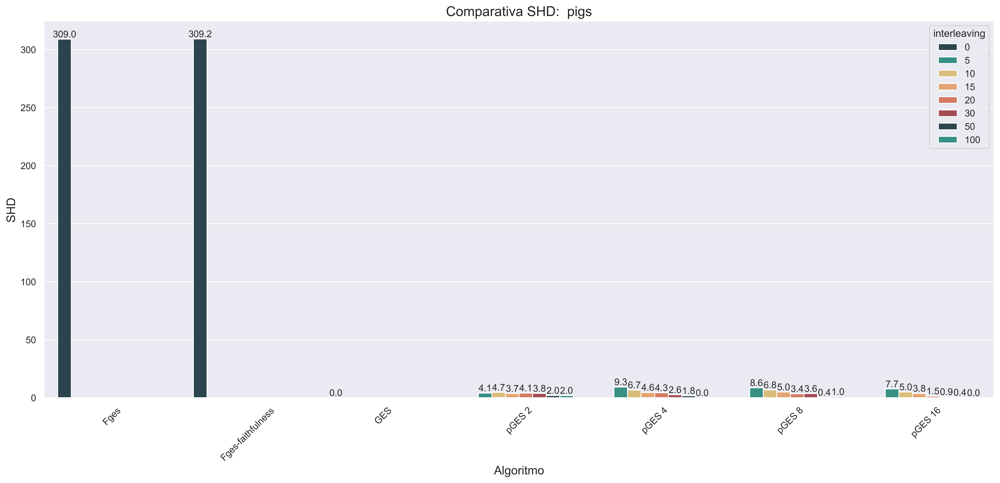

In [250]:
plot("pigs", "SHD", 1, 11, interleaving=True)

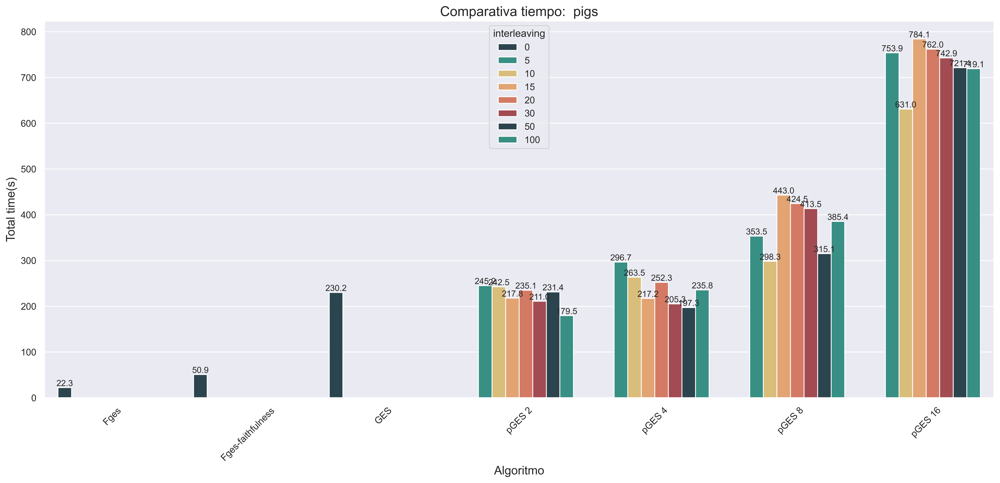

In [251]:
plot("pigs",  "Total time(s)", 1, 10, interleaving=True)

### Link

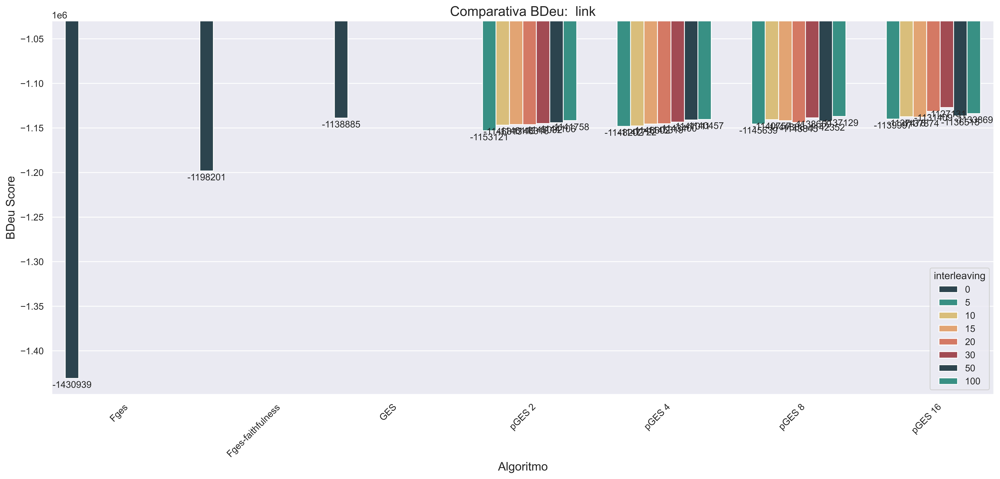

In [252]:
plot("link", "BDeu Score", 0, 11, interleaving=True)

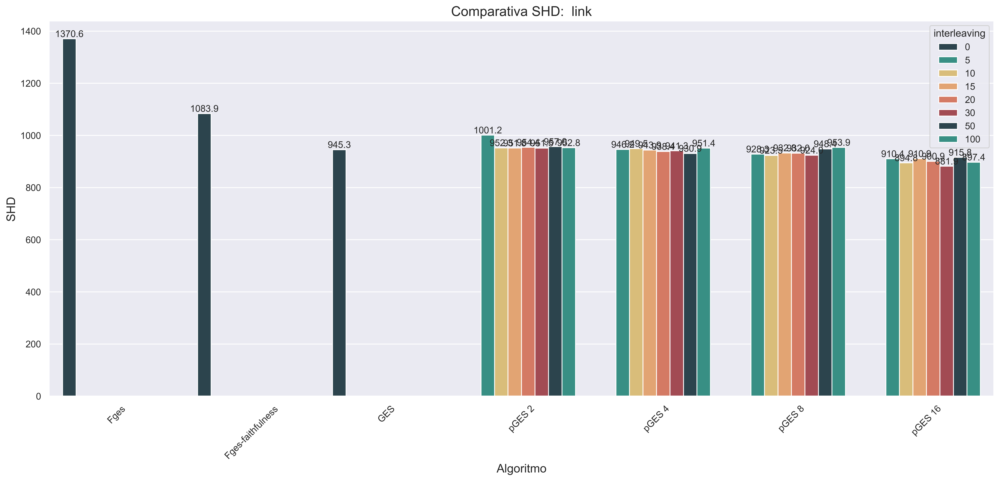

In [253]:
plot("link", "SHD", 1, 11, interleaving=True)

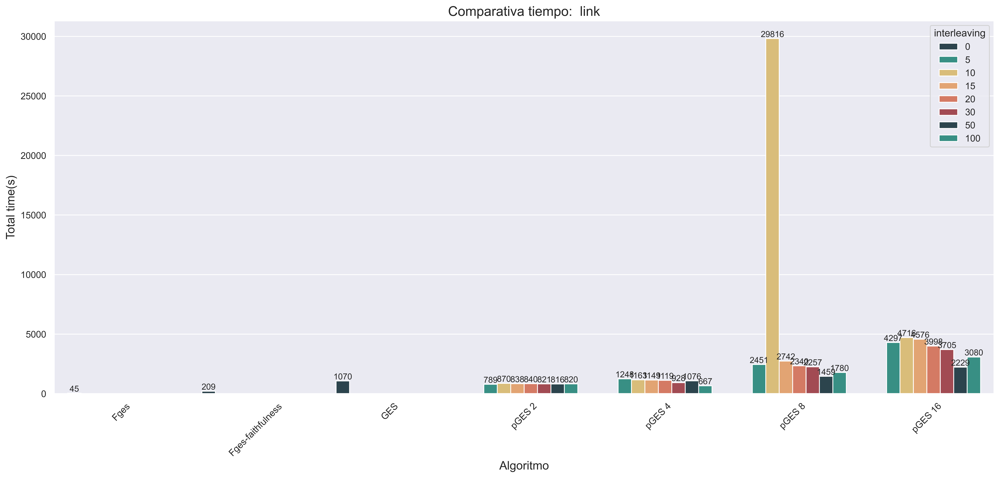

In [254]:
plot("link",  "Total time(s)", 0, 10, interleaving=True)

### Munin

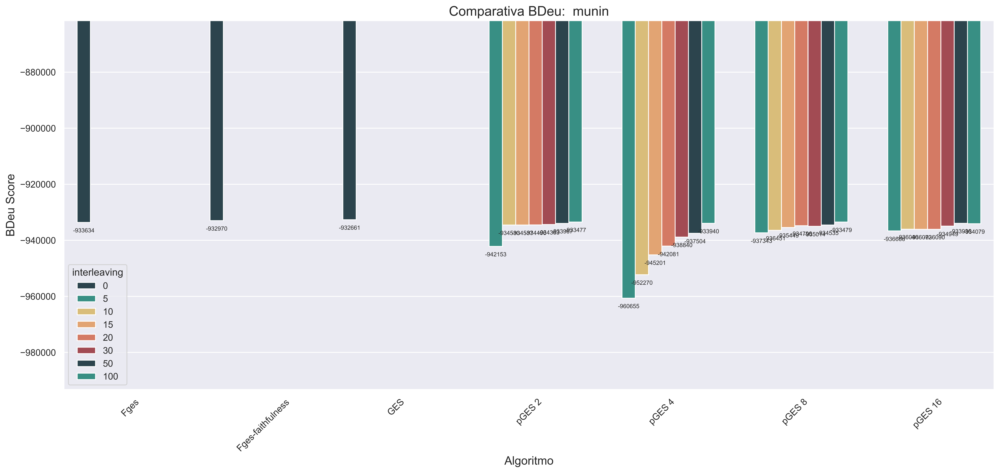

In [14]:
plot("munin", "BDeu Score", 0, 7, interleaving=True)

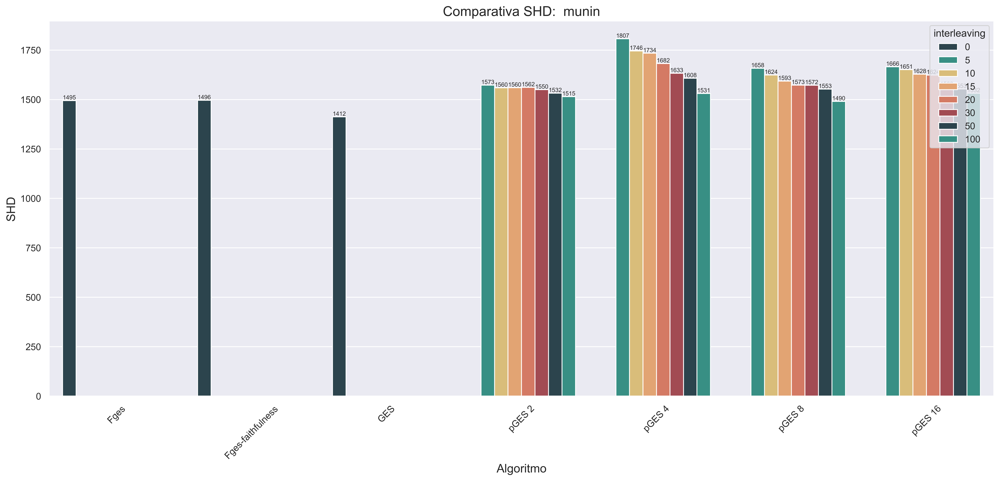

In [12]:
plot("munin", "SHD", 0, 7, interleaving=True)

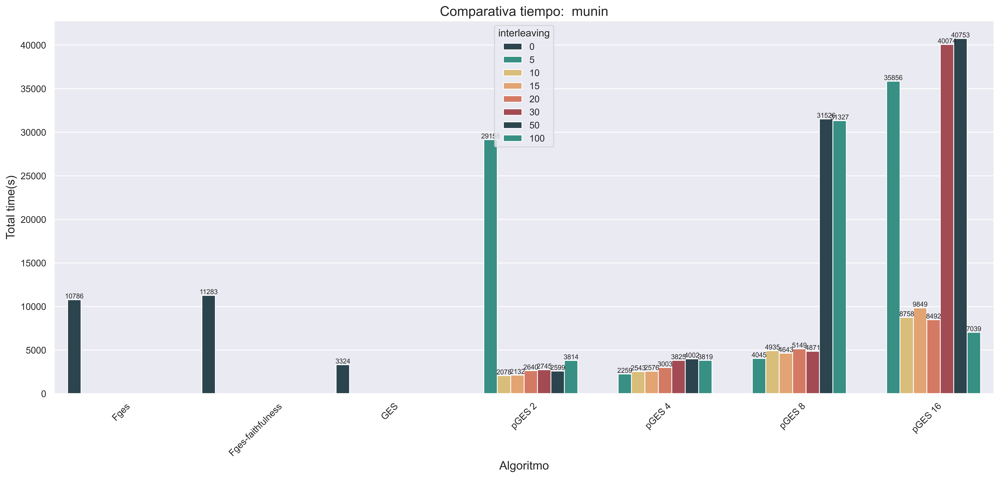

In [13]:
plot("munin", "Total time(s)", 0, 8, interleaving=True)